In [1]:
import gudhi
import numpy as np
import plotly.graph_objs as go
from plotly.offline import iplot
import plotly.express as px
from tda_utils import *
from sklearn.cluster import KMeans
import random
from sklearn.datasets import make_blobs
import matplotlib.pyplot as plt 
from matplotlib.pyplot import figure
from scipy.spatial.distance import cdist, pdist, squareform
from scipy.sparse.csgraph import minimum_spanning_tree
from tqdm import tqdm

figure(figsize=(8, 6), dpi=80)

<Figure size 640x480 with 0 Axes>

<Figure size 640x480 with 0 Axes>

# Higher Order Voronoi Diagrams

### Voronoi Diagrams

**Definition:** Let $L = {p_1, \ldots, p_n} \subset \mathbb R^d$ denote the landmark points. Then for every nonempty subset $\{ i_1, i_2, \ldots, i_m\} \subset [n]$, we define the *higher order Voronoi Cell:* 

$$V_{\{ i_1, \ldots, i_m \}}(L) = \{ p : j \not \in \{i_1, \ldots, i_m\} \Rightarrow d(p,p_i) \leq d(p, p_j) \}$$

In [2]:
X, y_true = make_blobs(n_samples=300, centers=3,
                       cluster_std=1.1, random_state=0)
kmeans = KMeans(n_clusters=5)
kmeans.fit(X);

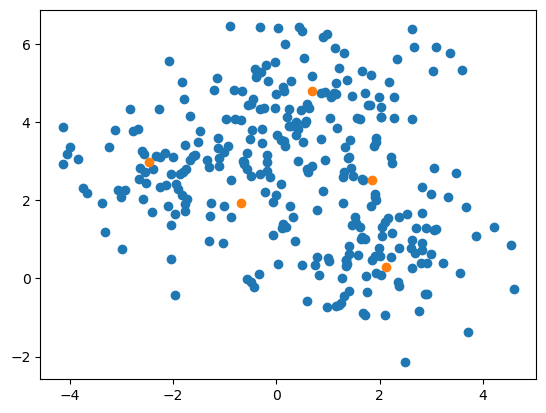

In [3]:
plt.scatter(X[:,0], X[:,1])
plt.scatter(kmeans.cluster_centers_[:,0], kmeans.cluster_centers_[:,1])

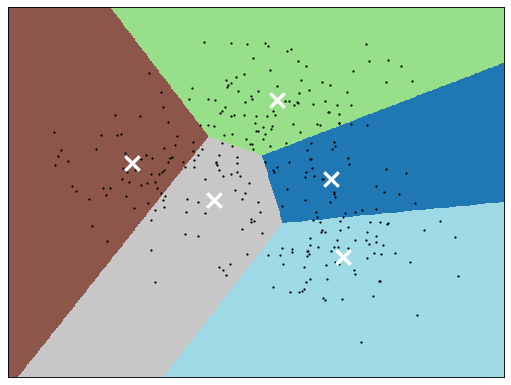

In [4]:
# Insert Code Here
ordered_voronoi_diagram(X,kmeans.cluster_centers_,1)

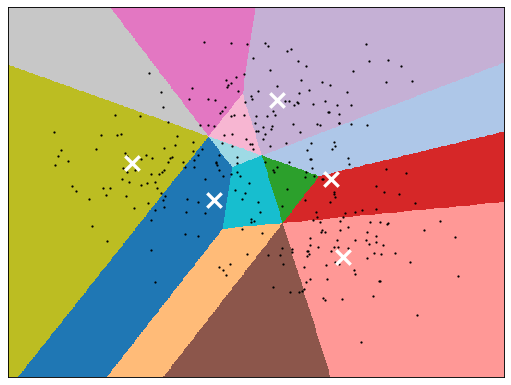

In [5]:
ordered_voronoi_diagram(X,kmeans.cluster_centers_,2)

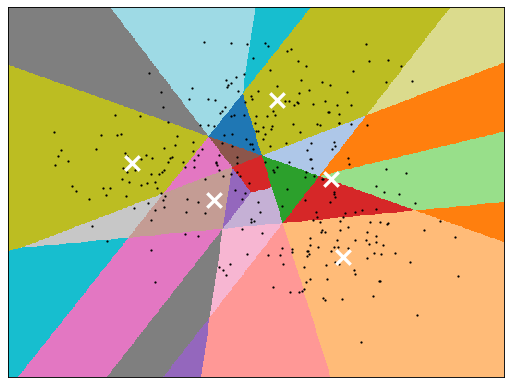

In [6]:
ordered_voronoi_diagram(X,kmeans.cluster_centers_,3)

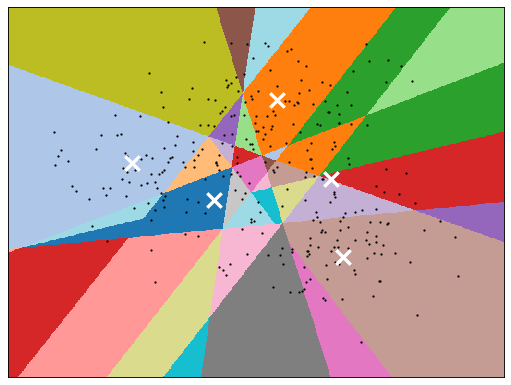

In [7]:
ordered_voronoi_diagram(X,kmeans.cluster_centers_,4)

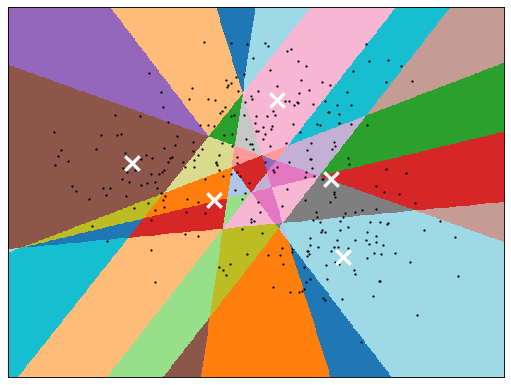

In [8]:
ordered_voronoi_diagram(X,kmeans.cluster_centers_,5)

# The Alpha Complex 

### The Delaunay Triangulation

**Definition:** Given a finite set $L \subset \mathbb R^d$ then the *Delaunay Triangulation* is the nerve of the First-Order Voronoi Diagram: 

$$Del(S) := \{ \sigma \subset S : \bigcap_{u \in \sigma } V_{u}(S) \not = \emptyset \}$$

A couple of notes: 
- We get the Delaunay triangulation by connecting two sites by a straight edge whenever the corresponding two Voronoi regions share an edge 
- Generically, the intersection of any four or more Voronoi regions is empty. 
- Three Voronoi regions may intersect in a point, which is then the endpoint of the three edges formed by taking pairwise intersections.


![Example Delaunay Triangulation](images/delaunay.png "Example Delaunay Triangulation")


### The Alpha Complex

**Definition:** For every point in a given set $S$, we define the cover

$$R_r(x) := B_r(x) \cap V_x(S)$$

then the *Alpha Complex* is the nerve of the cover: 

$$Alpha(S, r) := \{ \sigma \subset S : \bigcap_{u \in \sigma } R_r(u) \not = \emptyset \}$$

Further, the filtration value of each simplice within the complex is defined as: 

$$f(\sigma) := \min \{ r : \bigcap_{u \in \sigma } R_r(u) \not = \emptyset \} $$


![Example Alpha Complex](images/alpha_1.png "Example Alpha Complex")

![Example Alpha Complex 2](images/alpha_2.png "Example Alpha Complex 2")

Note: Nothing interesting can be defined for higher dimensional simplices. 




### Reattempting the Torus

In [9]:
# Adjust these hyperparameters
n = 10000
R = 0.5

In [10]:
D = 3
a = 5
b = 2
perturb = 5

def parametrized_torus(theta,phi):
    
    return ((a + b * math.cos(theta)) * math.cos(phi) + b / perturb * np.random.normal(), (a + b * math.cos(theta)) * math.sin(phi) + b / perturb * np.random.normal(), b * math.sin(theta) + b / perturb * np.random.normal())

zfunc = np.vectorize(parametrized_torus)

In [11]:
Theta = 2 * math.pi * np.random.rand(n)
Phi = 2 * math.pi * (np.random.rand(n) - 0.5)
X, Y, Z = zfunc(Theta, Phi)

In [12]:
things_to_plot = []

things_to_plot.append(
        go.Scatter3d(x=X, y=Y, z=Z,
            mode='markers',
            marker=dict(
                size=5,
                color=X,                # set color to an array/list of desired values
                colorscale=px.colors.qualitative.Dark24,   # choose a colorscale
                opacity=1
                ), 
            hoverinfo='none',
            showlegend=False)
    )

layout = go.Layout(autosize=False, width=900, height=900, showlegend = False, scene=dict(
                 aspectmode='data'
         ))
fig = go.Figure(data = things_to_plot, layout = layout)
iplot(fig)

In [13]:
S = np.stack((X,Y,Z)).T

In [14]:
Alpha_cplx_tree = gudhi.AlphaComplex(points = S)

In [15]:
example = Alpha_cplx_tree.create_simplex_tree(max_alpha_square = R)

In [16]:
Alpha_cplx = defaultdict(list)
for simplex, value in example.get_simplices():
    Alpha_cplx[len(simplex)-1].append((simplex, value))

In [17]:
my_persistence = example.persistence(homology_coeff_field = 2)

/opt/anaconda3/envs/apptop/lib/python3.10/site-packages/gudhi/persistence_graphical_tools.py:105: UserWarning:

This function is not available.
ModuleNotFoundError: No module named 'matplotlib'.



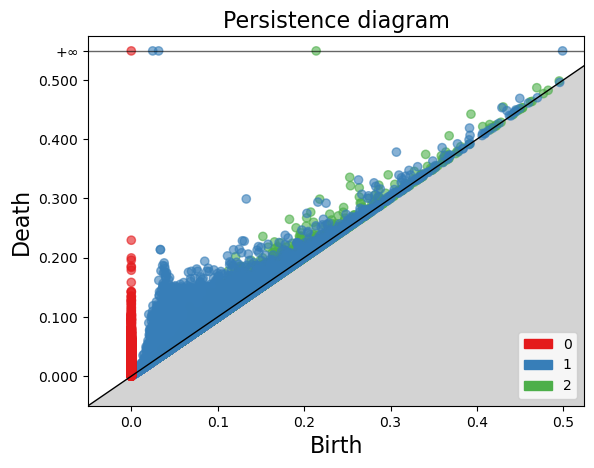

In [18]:
gudhi.plot_persistence_diagram(my_persistence, legend=True)
plt.show()

In [19]:
betti_numbers = {}
for i in range(D + 1):
    betti_numbers[i] = 0
for bar, bd in my_persistence:
    if bd[1] > R: 
        betti_numbers[bar] += 1

print("Betti Numbers up to Dimension",D," over the field F_2")
print(betti_numbers)

Betti Numbers up to Dimension 3  over the field F_2
{0: 1, 1: 3, 2: 1, 3: 0}


In [20]:
draw_geometric_simplcial_complex(Alpha_cplx, S, draw_points = True, draw_edges = True, draw_surfaces = True)

Note: For computing higher dimensional datasets, my advisor and I developed a software package (to be released soon) that calculates the Alpha Complex beyond 3 dimensions. (https://www.nature.com/articles/s41598-024-63971-3)

# A Novel Sublevel-Set Filtration

There's interesting filtrations being defined all the time, especially ones motivated by statistics. Consider the following paper: https://arxiv.org/abs/2106.04020. 

Suppose $X \subset \mathbb R^d,$ and let $f : \mathbb P(X) \rightarrow \mathbb R_{\geq 0}$ be a \textbf{potential function}. Let $L$ denote the set of landmark points. 

We define the **filtered complex** $(X_L, f_L)$ as follows: 
1. $k$-simplex $\Delta \in X_L$ if the higher order Voronoi diagram $V_{\Delta}(L) \cap X$. 
2. The filtration function is defined by 
    $$f_L(\Delta) = \max_{\tau \subset \Delta} f(V_{\tau}(L) \cap X)$$
    
### Define a Filtration Potential Function 

Define 

$$f_L(V_{\Delta}(L) \cap X) = \frac{1}{\#|V_{\Delta}(L) \cap X|}$$


**Proposition:** $f(S) \leq 1$ for all sets $S \subset \mathbb P(X)$. 

![Computation Efficiency](images/ComputationEfficiency.png "Computational Efficiency")

In [21]:
# Adjust these hyperparameters
n = 10000
R = 1

In [22]:
D = 3
a = 5
b = 2
perturb = 5

def parametrized_torus(theta,phi):
    
    return ((a + b * math.cos(theta)) * math.cos(phi) + b / perturb * np.random.normal(), (a + b * math.cos(theta)) * math.sin(phi) + b / perturb * np.random.normal(), b * math.sin(theta) + b / perturb * np.random.normal())

zfunc = np.vectorize(parametrized_torus)

In [23]:
Theta = 2 * math.pi * np.random.rand(n)
Phi = 2 * math.pi * (np.random.rand(n) - 0.5)
X, Y, Z = zfunc(Theta, Phi)

In [24]:
S = np.stack((X,Y,Z)).T

### Landmark Points to make complex smaller

In [25]:
num_landmarks = 100

chosen_indices = random.sample(range(n), num_landmarks)

L = S[chosen_indices, :]

### Calculate Complex

In [26]:
SubLevel_cplx = SublevelSetFiltration(L, S, max_dimension = 3, max_radius = R)

Evaluating Dimension 0


100%|████████████████████████████████████████| 100/100 [00:00<00:00, 203.63it/s]


Evaluating Dimension 1


100%|████████████████████████████████████| 10000/10000 [00:51<00:00, 195.57it/s]


	Number of Connected Components:  1
Estimating Number of Facets for dimension  2 Part 1:


100%|██████████████████████████████████| 1142/1142 [00:00<00:00, 1691944.60it/s]


Estimating Number of Facets for dimension  2 Part 2:


100%|██████████████████████████████████████| 100/100 [00:00<00:00, 15639.88it/s]


Evaluating Dimension 2


100%|██████████████████████████████████████| 3400/3400 [00:18<00:00, 180.71it/s]


Estimating Number of Facets for dimension  3 Part 1:


100%|██████████████████████████████████| 3238/3238 [00:00<00:00, 1605337.63it/s]


Estimating Number of Facets for dimension  3 Part 2:


100%|████████████████████████████████████| 3238/3238 [00:00<00:00, 58421.37it/s]


Evaluating Dimension 3


100%|████████████████████████████████████| 20130/20130 [02:06<00:00, 159.31it/s]


### Extract Persistence

In [27]:
example2 = gudhi.SimplexTree()
filtration = []
for d in range(D + 1):
    for facet, val in SubLevel_cplx[d]:
        filtration.append((facet, val))
        example2.insert(facet, filtration=val)

In [28]:
my_persistence = example2.persistence(homology_coeff_field = 2)

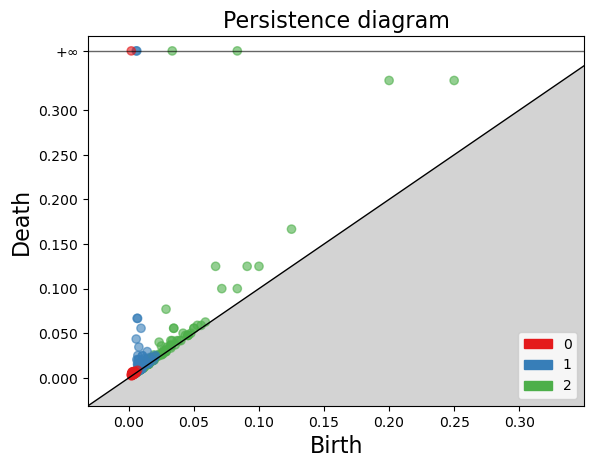

In [29]:
gudhi.plot_persistence_diagram(my_persistence, legend=True)
plt.show()

In [30]:
betti_numbers = {}
for i in range(D + 1):
    betti_numbers[i] = 0
for bar, bd in my_persistence:
    if bd[1] > R: 
        betti_numbers[bar] += 1

print("Betti Numbers up to Dimension",D," over the field F_2")
print(betti_numbers)

Betti Numbers up to Dimension 3  over the field F_2
{0: 1, 1: 2, 2: 2, 3: 0}


In [31]:
draw_geometric_simplcial_complex(SubLevel_cplx, L, draw_points = True, draw_edges = True, draw_surfaces = True)

### Final Exam! 

The Rules: 

1. You are **not** allowed to plot these manifolds 
2. You are **not** allowed to look in the utils file
3. You are allowed to use any of the tools from this course (or others) that you believe should work 

In [32]:
mystery_dataset_1()

array([[  0.10562265,  -7.08863062,   3.04112685,  -2.68805317],
       [ -0.66337124,  12.68475567,  -2.7325175 ,  -3.01894419],
       [  8.50651567, -11.01758116,  -2.89967945,   1.06359516],
       ...,
       [  4.79426308,   8.28847784,  -4.62288017,  -2.49208753],
       [ -6.37458597,   1.511654  ,  -0.43912933,  -3.05300895],
       [  3.03931551,   3.96780024,   0.42889985,  -0.14047297]])

In [33]:
mystery_dataset_2()

array([[ 1.59195826e+01, -1.63790505e+01, -2.75987651e+00,
         6.75072518e+02],
       [ 2.29144372e-01,  2.52179742e+01,  6.20189307e-02,
         6.65870968e+02],
       [ 2.61544831e+01,  2.81581972e+01,  8.98286835e+00,
         6.18270118e+02],
       ...,
       [-1.53354199e+01, -4.24415493e+01,  2.28612009e+01,
         3.50610575e+02],
       [ 2.23273502e+01, -3.97332090e+00, -1.63113226e+01,
         3.18852405e+02],
       [-3.44890905e+00, -2.95016143e+01,  1.04051934e+01,
         2.50109504e+02]])

# The End

That's it for now! So long, folks! 